tobac example: Tracking of deep convection based on OLR from convection permitting model simulations
==
This example notebook demonstrates the use of tobac to track deep convection based on the outgoing longwave radiation (OLR) from convection permitting simulations.

The simulation results used in this example were performed as part of the ACPC deep convection intercomparison  case study (http://acpcinitiative.org/Docs/ACPC_DCC_Roadmap_171019.pdf) with WRF using the Morrison microphysics scheme. Simulations were performed with a horizontal grid spacing of 4.5 km.

The data used in this example is downloaded from "zenodo link" automatically as part of the notebooks (This only has to be done once for all the tobac example notebooks).

**Import libraries:**

In [1]:
# Import a range of python libraries used in this notebook:
import iris
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import iris.plot as iplt
import iris.quickplot as qplt
import shutil
import datetime
from six.moves import urllib
from pathlib import Path
%matplotlib inline

In [2]:
# Import tobac itself:
import tobac
print('using tobac version', str(tobac.__version__))

using tobac version 1.5


In [3]:
# Disable a few warnings:
import warnings
warnings.filterwarnings('ignore', category=UserWarning, append=True)
warnings.filterwarnings('ignore', category=RuntimeWarning, append=True)
warnings.filterwarnings('ignore', category=FutureWarning, append=True)
warnings.filterwarnings('ignore',category=pd.io.pytables.PerformanceWarning)

**Download example data:**  
The actual download is only necessary once for all example notebooks.


In [4]:
data_out=Path('../')

In [5]:
# Download the data: This only has to be done once for all tobac examples and can take a while
data_file = list(data_out.rglob('data/Example_input_OLR_model.nc'))
if len(data_file) == 0:
    file_path='https://zenodo.org/record/3195910/files/climate-processes/tobac_example_data-v1.0.1.zip'
    #file_path='http://zenodo..'
    tempfile=Path('temp.zip')
    print('start downloading data')
    request=urllib.request.urlretrieve(file_path, tempfile)
    print('start extracting data')
    shutil.unpack_archive(tempfile, data_out)
    tempfile.unlink()
    print('data extracted')
    data_file = list(data_out.rglob('data/Example_input_OLR_model.nc'))

In [6]:
#Load Data from downloaded file:
OLR=iris.load_cube(data_file[0],'OLR')

In [7]:
OLR

Olr (W m-2),time,south_north,west_east
Shape,96,110,132
Dimension coordinates,,,
time,x,-,-
south_north,-,x,-
west_east,-,-,x
Auxiliary coordinates,,,
projection_y_coordinate,-,x,-
y,-,x,-
latitude,-,x,x
longitude,-,x,x


In [8]:
#Set up directory to save output and plots:
savedir=Path("Save")
if not savedir.is_dir():
    savedir.mkdir()
plot_dir=Path("Plot")
if not plot_dir.is_dir():
    plot_dir.mkdir()

**Feature detection:**  
Feature detection is performed based on OLR field and a set of thresholds.

In [9]:
# Determine temporal and spatial sampling:
dxy,dt=tobac.get_spacings(OLR)

In [10]:
# Dictionary containing keyword arguments for feature detection step (Keywords could also be given directly in the function call).
parameters_features={}
parameters_features['position_threshold']='weighted_diff'
parameters_features['sigma_threshold']=0.5
parameters_features['n_min_threshold']=4
parameters_features['target']='minimum'
parameters_features['threshold']=[250,225,200,175,150]

See https://tobac.readthedocs.io/en/rc_v1.5.0/threshold_detection_parameters.html for more information about these input parameters

In [11]:
# Perform feature detection:
print('starting feature detection')
Features=tobac.feature_detection_multithreshold(OLR,dxy, **parameters_features)
Features.to_hdf(savedir / 'Features.h5', 'table')
print('feature detection performed and saved')

starting feature detection
feature detection performed and saved


Features are saved as a pandas dataframe, with one row for each feature detected at each time step

Information about each feature, including its centroid position, threshold value and number of pixels are recorded

In [12]:
Features

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,south_north,west_east,projection_y_coordinate,y,latitude,longitude,projection_x_coordinate,x
0,0,5,62.743547,59.631834,9,250,1,2013-06-19 19:05:00,2013-06-19 19:05:00,218.743547,260.631834,9.865960e+05,218.743547,30.232511,-92.171414,1.175093e+06,260.631834
1,0,8,67.672946,53.464557,6,250,2,2013-06-19 19:05:00,2013-06-19 19:05:00,223.672946,254.464557,1.008778e+06,223.672946,30.441024,-92.459497,1.147341e+06,254.464557
2,0,11,73.655933,130.435766,5,250,3,2013-06-19 19:05:00,2013-06-19 19:05:00,229.655933,331.435766,1.035702e+06,229.655933,30.565232,-88.779386,1.493711e+06,331.435766
3,0,12,74.385746,122.150648,6,250,4,2013-06-19 19:05:00,2013-06-19 19:05:00,230.385746,323.150648,1.038986e+06,230.385746,30.613178,-89.172567,1.456428e+06,323.150648
4,0,17,64.398814,49.861904,8,225,5,2013-06-19 19:05:00,2013-06-19 19:05:00,220.398814,250.861904,9.940447e+05,220.398814,30.309673,-92.634448,1.131129e+06,250.861904
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,95,26,56.492262,115.478057,6,175,1581,2013-06-20 03:00:00,2013-06-20 03:00:00,212.492262,316.478057,9.584652e+05,212.492262,29.892220,-89.531826,1.426401e+06,316.478057
1581,95,28,71.666555,122.473032,62,175,1582,2013-06-20 03:00:00,2013-06-20 03:00:00,227.666555,323.473032,1.026749e+06,227.666555,30.500885,-89.163832,1.457879e+06,323.473032
1582,95,29,69.802409,15.037454,10,175,1583,2013-06-20 03:00:00,2013-06-20 03:00:00,225.802409,216.037454,1.018361e+06,225.802409,30.551058,-94.290814,9.744185e+05,216.037454
1583,95,30,75.380948,109.634011,19,175,1584,2013-06-20 03:00:00,2013-06-20 03:00:00,231.380948,310.634011,1.043464e+06,231.380948,30.678967,-89.767490,1.400103e+06,310.634011


**Segmentation:**  
Segmentation is performed with watershedding based on the detected features and a single threshold value.

In [13]:
# Dictionary containing keyword options for the segmentation step:
parameters_segmentation={}
parameters_segmentation['target']='minimum'
parameters_segmentation['method']='watershed'
parameters_segmentation['threshold']=250

See https://tobac.readthedocs.io/en/rc_v1.5.0/segmentation_parameters.html for more information

In [14]:
# Perform segmentation and save results:
print('Starting segmentation based on OLR.')
Mask_OLR,Features_OLR=tobac.segmentation_2D(Features,OLR,dxy,**parameters_segmentation)
print('segmentation OLR performed, start saving results to files')
iris.save([Mask_OLR], savedir / 'Mask_Segmentation_OLR.nc', zlib=True, complevel=4)                
Features_OLR.to_hdf(savedir / 'Features_OLR.h5', 'table')
print('segmentation OLR performed and saved')

Starting segmentation based on OLR.
segmentation OLR performed, start saving results to files
segmentation OLR performed and saved


The mask data is saved as an iris cube with the same dimensionality as the input data. It identifies the segmented regions for each feature

In [15]:
Mask_OLR

Segmentation Mask (1),time,south_north,west_east
Shape,96,110,132
Dimension coordinates,,,
time,x,-,-
south_north,-,x,-
west_east,-,-,x
Auxiliary coordinates,,,
projection_y_coordinate,-,x,-
y,-,x,-
latitude,-,x,x
longitude,-,x,x


**Trajectory linking:**  
Features are linked into cloud trajectories using the trackpy library (http://soft-matter.github.io/trackpy). This takes the feature positions determined in the feature detection step into account but does not include information on the shape of the identified objects.**

In [16]:
# Arguments for trajectory linking:
parameters_linking={}
parameters_linking['v_max']=20
parameters_linking['stubs']=2
parameters_linking['order']=1
parameters_linking['extrapolate']=0
parameters_linking['memory']=0
parameters_linking['adaptive_stop']=0.2
parameters_linking['adaptive_step']=0.95
parameters_linking['subnetwork_size']=100
parameters_linking['method_linking']= 'predict'

See https://tobac.readthedocs.io/en/rc_v1.5.0/linking.html for more info

In [17]:
# Perform linking and save results to file:
Track=tobac.linking_trackpy(Features, OLR, dt=dt, dxy=dxy, **parameters_linking)
Track.to_hdf(savedir / 'Track.h5', 'table')

Frame 95: 12 trajectories present.


Tracking produces a pandas dataframe, with one row for each feature. Now each feature has an assigned cell, as well as its time along the lifetime of the cell. 

By default, features not assigned to tracks (aka "stubs") gets assigned the cell number "-1", but this can be specified by the user

In [18]:
Track

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,south_north,west_east,projection_y_coordinate,y,latitude,longitude,projection_x_coordinate,x,cell,time_cell
0,0,5,62.743547,59.631834,9,250,1,2013-06-19 19:05:00,2013-06-19 19:05:00,218.743547,260.631834,9.865960e+05,218.743547,30.232511,-92.171414,1.175093e+06,260.631834,1,0 days 00:00:00
1,0,8,67.672946,53.464557,6,250,2,2013-06-19 19:05:00,2013-06-19 19:05:00,223.672946,254.464557,1.008778e+06,223.672946,30.441024,-92.459497,1.147341e+06,254.464557,2,0 days 00:00:00
2,0,11,73.655933,130.435766,5,250,3,2013-06-19 19:05:00,2013-06-19 19:05:00,229.655933,331.435766,1.035702e+06,229.655933,30.565232,-88.779386,1.493711e+06,331.435766,3,0 days 00:00:00
3,0,12,74.385746,122.150648,6,250,4,2013-06-19 19:05:00,2013-06-19 19:05:00,230.385746,323.150648,1.038986e+06,230.385746,30.613178,-89.172567,1.456428e+06,323.150648,4,0 days 00:00:00
4,0,17,64.398814,49.861904,8,225,5,2013-06-19 19:05:00,2013-06-19 19:05:00,220.398814,250.861904,9.940447e+05,220.398814,30.309673,-92.634448,1.131129e+06,250.861904,5,0 days 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,95,26,56.492262,115.478057,6,175,1581,2013-06-20 03:00:00,2013-06-20 03:00:00,212.492262,316.478057,9.584652e+05,212.492262,29.892220,-89.531826,1.426401e+06,316.478057,288,0 days 00:05:00
1581,95,28,71.666555,122.473032,62,175,1582,2013-06-20 03:00:00,2013-06-20 03:00:00,227.666555,323.473032,1.026749e+06,227.666555,30.500885,-89.163832,1.457879e+06,323.473032,272,0 days 00:40:00
1582,95,29,69.802409,15.037454,10,175,1583,2013-06-20 03:00:00,2013-06-20 03:00:00,225.802409,216.037454,1.018361e+06,225.802409,30.551058,-94.290814,9.744185e+05,216.037454,275,0 days 00:35:00
1583,95,30,75.380948,109.634011,19,175,1584,2013-06-20 03:00:00,2013-06-20 03:00:00,231.380948,310.634011,1.043464e+06,231.380948,30.678967,-89.767490,1.400103e+06,310.634011,-1,0 days 07:45:00


**Visualisation:**

In [19]:
# Set extent of maps created in the following cells:
axis_extent = [-95, -89, 28, 32]        

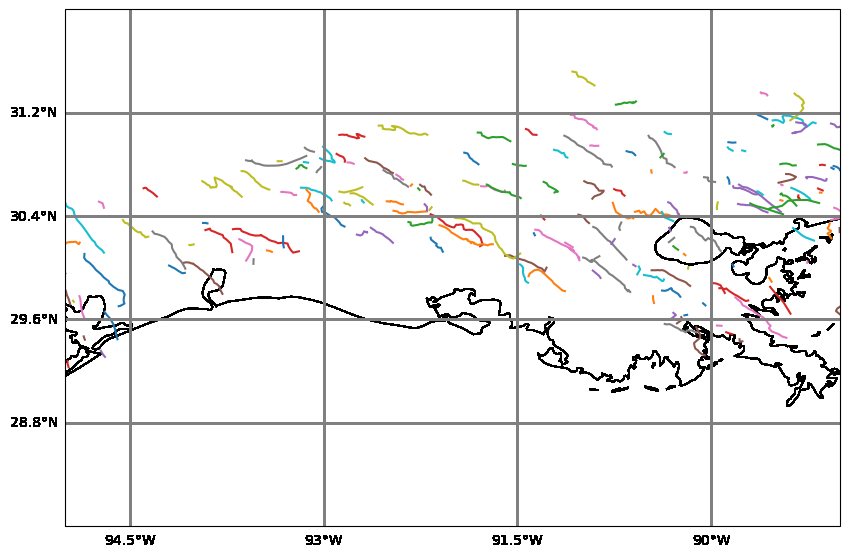

In [20]:
# Plot map with all individual tracks:
import cartopy.crs as ccrs
fig_map, ax_map = plt.subplots(figsize=(10,10), subplot_kw={'projection': ccrs.PlateCarree()})
ax_map = tobac.map_tracks(Track, axis_extent=axis_extent,  axes=ax_map)

In [21]:
# Create animation of tracked clouds and outlines with OLR as a background field
animation_test_tobac=tobac.animation_mask_field(
    Track,Features,OLR,Mask_OLR, 
    axis_extent=axis_extent, vmin=80,vmax=330, 
    plot_outline=True, plot_marker=True, marker_track='x', 
    plot_number=True, plot_features=True
)

In [22]:
# Display animation:
from IPython.display import HTML, Image, display
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

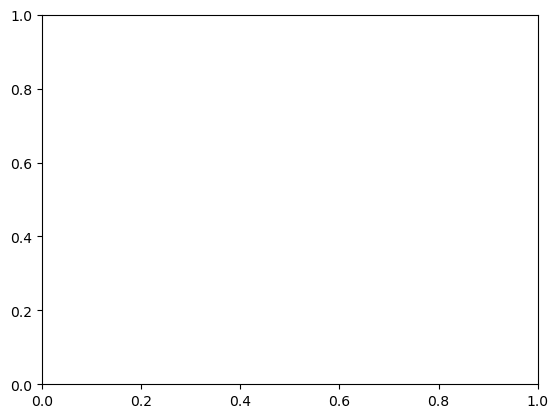

In [23]:
HTML(animation_test_tobac.to_jshtml())

Text(0, 0.5, 'counts')

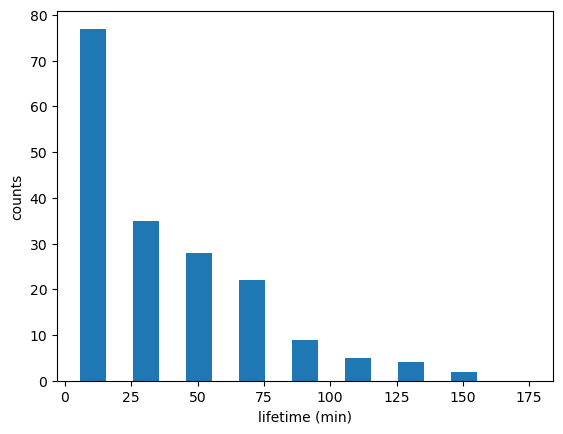

In [24]:
# Lifetimes of tracked clouds:
fig_lifetime,ax_lifetime=plt.subplots()
tobac.plot_lifetime_histogram_bar(Track,axes=ax_lifetime,bin_edges=np.arange(0,200,20),density=False,width_bar=10)
ax_lifetime.set_xlabel('lifetime (min)')
ax_lifetime.set_ylabel('counts')
         